In [ ]:
# Install the ultralytics package using pip
!pip install -q ultralytics

from ultralytics import YOLO
from matplotlib import pyplot as plt
from PIL import Image

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 914.9/914.9 kB 13.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 58.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 53.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 37.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 78.6 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultra

In [ ]:
!wget https://uabox.univ-angers.fr/s/XWRYs3j7Aw8T9f7/download/Apple.zip

--2025-02-04 09:58:24--  https://uabox.univ-angers.fr/s/XWRYs3j7Aw8T9f7/download/Apple.zip
Resolving uabox.univ-angers.fr (uabox.univ-angers.fr)... 193.49.144.31
Connecting to uabox.univ-angers.fr (uabox.univ-angers.fr)|193.49.144.31|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/zip]
Saving to: ‘Apple.zip’

Apple.zip               [       <=>          ]   1.95G  28.4MB/s    in 74s     

2025-02-04 09:59:40 (26.9 MB/s) - ‘Apple.zip’ saved [2094790569]



In [ ]:
!unzip -q /content/Apple.zip

In [17]:
#Instance
model = YOLO('yolo11n-seg.pt')  # Transfer the weights CSPDarknet53 from a pretrained model (recommended for training)
# model = YOLO('yolov8n-seg.pt')

In [ ]:
%cat /content/Apple/La_et_al.yaml

names:
- Tree
nc: 1
test: /content/Apple/AppleTreeDataset/images/val
train: /content/Apple/AppleTreeDataset/images/train
val: /content/Apple/AppleTreeDataset/images/val

lr0: 0.01

flipud: 0.5
hsv_v : 0.1

In [16]:
#Define a project --> Destination directory for all results
project = "/content/detection"
epoch = 100
#Define subdirectory for this specific training
name = "apple" #note that if you run the training again, it creates a directory: 200_epochs-2

In [ ]:
results = model.train(data='/content/Apple/La_et_al.yaml',
                      lr0=0.01,
                      hsv_v=0.1,
                      close_mosaic=False,
                      project=project,
                      name=name,
                      epochs=epoch,
                      optimizer="SGD",
                      patience=4, #I am setting patience=0 to disable early stopping.
                      batch=4,
                      imgsz=512)

Ultralytics 8.3.70 🚀 Python-3.11.11 torch-2.5.1+cu124 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=segment, mode=train, model=yolo11n-seg.pt, data=/content/Apple/La_et_al.yaml, epochs=100, time=None, patience=4, batch=4, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/detection, name=apple2, exist_ok=False, pretrained=True, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=False, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_co

train: Scanning /content/Apple/AppleTreeDataset/labels/train.cache... 70 images, 0 backgrounds, 0 corrupt: 100%|██████████| 70/70 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/Apple/AppleTreeDataset/labels/val.cache... 30 images, 0 backgrounds, 0 corrupt: 100%|██████████| 30/30 [00:00<?, ?it/s]


Plotting labels to /content/detection/apple2/labels.jpg... 
optimizer: SGD(lr=0.01, momentum=0.937) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 512 train, 512 val
Using 0 dataloader workers
Logging results to /content/detection/apple2
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G      1.642      5.439      2.632      1.927          8        512: 100%|██████████| 18/18 [01:48<00:00,  6.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:24<00:00,  6.14s/it]

                   all         30         30    0.00333          1      0.272      0.147    0.00333          1      0.255     0.0904



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      2/100         0G      1.267      3.749      2.474      1.647          5        512: 100%|██████████| 18/18 [01:34<00:00,  5.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:25<00:00,  6.42s/it]

                   all         30         30    0.00333          1      0.307      0.178    0.00333          1      0.301      0.118



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      3/100         0G      1.007      3.126      2.374      1.467          8        512: 100%|██████████| 18/18 [01:35<00:00,  5.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:24<00:00,  6.07s/it]

                   all         30         30    0.00333          1      0.519      0.344    0.00333          1      0.497      0.241



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      4/100         0G     0.8558       2.78      2.299      1.359          8        512: 100%|██████████| 18/18 [01:38<00:00,  5.46s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:25<00:00,  6.36s/it]

                   all         30         30    0.00333          1      0.876      0.595    0.00333          1      0.876      0.315



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      5/100         0G     0.8563      2.366      2.138      1.311          6        512: 100%|██████████| 18/18 [01:32<00:00,  5.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:24<00:00,  6.23s/it]

                   all         30         30    0.00333          1      0.977      0.733    0.00322      0.967       0.94      0.172



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      6/100         0G     0.9038      2.734       2.01      1.301          8        512: 100%|██████████| 18/18 [01:29<00:00,  4.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:25<00:00,  6.35s/it]

                   all         30         30          1      0.932      0.992      0.702      0.857      0.799      0.877      0.236



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      7/100         0G     0.9389      2.805      1.902       1.35          8        512: 100%|██████████| 18/18 [01:33<00:00,  5.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:25<00:00,  6.38s/it]

                   all         30         30      0.932          1      0.977      0.764        0.9      0.967      0.931      0.356



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      8/100         0G     0.8816      2.245      1.758      1.297          8        512: 100%|██████████| 18/18 [01:36<00:00,  5.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:25<00:00,  6.48s/it]

                   all         30         30      0.958      0.761      0.923      0.244      0.503        0.4      0.324     0.0413



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      9/100         0G      1.051      2.428      1.647      1.426          6        512: 100%|██████████| 18/18 [01:36<00:00,  5.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:26<00:00,  6.56s/it]

                   all         30         30      0.994          1      0.995      0.804      0.994          1      0.995      0.458



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     10/100         0G     0.9164      2.314      1.385        1.3          8        512: 100%|██████████| 18/18 [01:35<00:00,  5.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:27<00:00,  6.84s/it]

                   all         30         30      0.917      0.967      0.981      0.544       0.86      0.867      0.907      0.216



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     11/100         0G     0.9365      2.113      1.331      1.368          5        512: 100%|██████████| 18/18 [01:40<00:00,  5.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:26<00:00,  6.61s/it]

                   all         30         30      0.724      0.961      0.803      0.515      0.724      0.961      0.803       0.35



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     12/100         0G     0.8792      2.064      1.163      1.261          7        512: 100%|██████████| 18/18 [01:40<00:00,  5.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:26<00:00,  6.67s/it]

                   all         30         30      0.779          1      0.995      0.786      0.779          1      0.995      0.548



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     13/100         0G     0.8972      2.123      1.168      1.237          6        512: 100%|██████████| 18/18 [01:53<00:00,  6.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:26<00:00,  6.59s/it]

                   all         30         30      0.996      0.967      0.993      0.786      0.996      0.967      0.993      0.457



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     14/100         0G     0.9264      2.202      1.049      1.257          6        512: 100%|██████████| 18/18 [01:33<00:00,  5.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:24<00:00,  6.18s/it]

                   all         30         30      0.998          1      0.995      0.796      0.998          1      0.995      0.596



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/18 [00:00<?, ?it/s]

## Inférence

In [10]:
import os
path_img = '/content/Apple/AppleTreeDataset/images/val'
A = [os.path.join(path_img,ix) for ix in os.listdir(path_img)]

In [20]:
model = YOLO('/content/detection/apple2/weights/best.pt')  # load a custom model


image 1/1 /content/Apple/AppleTreeDataset/images/val/210826-Cam1-T10-003.png: 512x352 1 Tree, 185.6ms
Speed: 3.8ms preprocess, 185.6ms inference, 3.7ms postprocess per image at shape (1, 3, 512, 352)


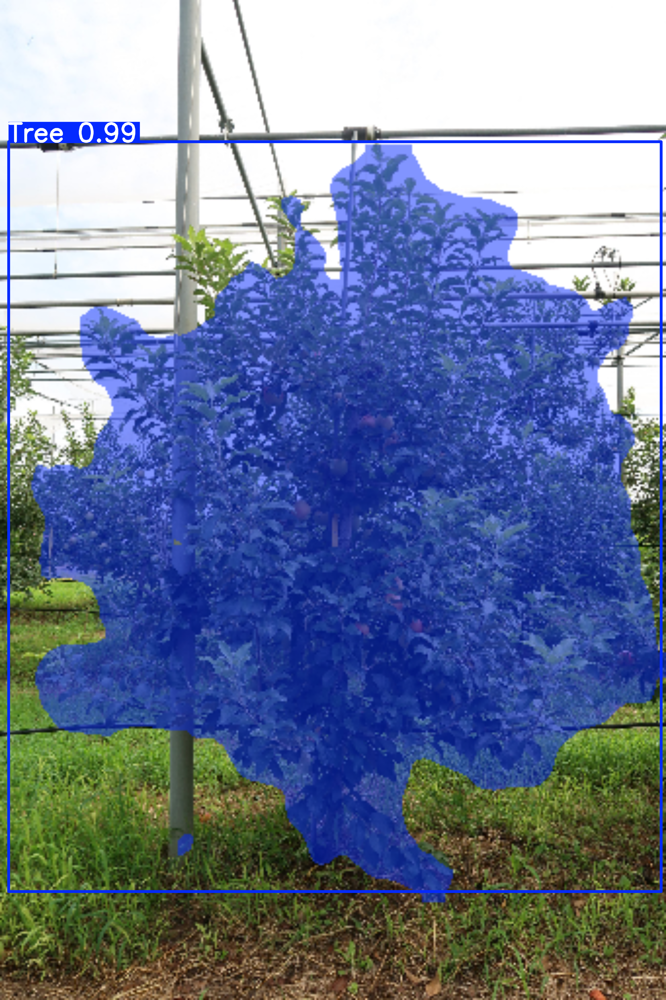

In [22]:
# Run batched inference on a list of images
results = model(A[0])  # return a list of Results objects

# Process results list
for result in results:
    boxes = result.boxes  # Boxes object for bounding box outputs
    masks = result.masks  # Masks object for segmentation masks outputs
    keypoints = result.keypoints  # Keypoints object for pose outputs
    probs = result.probs  # Probs object for classification outputs
    obb = result.obb  # Oriented boxes object for OBB outputs
    result.show()  # display to screen

In [24]:
!yolo val model='/content/detection/apple2/weights/best.pt' data='/content/Apple/La_et_al.yaml' split=test imgsz=640 batch=16 conf=0.25 iou=0.6

Ultralytics 8.3.70 🚀 Python-3.11.11 torch-2.5.1+cu124 CPU (Intel Xeon 2.20GHz)
YOLO11n-seg summary (fused): 265 layers, 2,834,763 parameters, 0 gradients, 10.2 GFLOPs
val: Scanning /content/Apple/AppleTreeDataset/labels/val.cache... 30 images, 0 backgrounds, 0 corrupt: 100% 30/30 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100% 2/2 [00:30<00:00, 15.12s/it]
                   all         30         30      0.997          1      0.995       0.71      0.997          1      0.995      0.638
Speed: 4.3ms preprocess, 305.8ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to runs/segment/val3
💡 Learn more at https://docs.ultralytics.com/modes/val
